<a href="https://colab.research.google.com/github/Hiteshhegde/NLPskills/blob/main/NhuntJobRec_Part1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Job Recommendation using Basic Naive Bayes  
### Importing neccesary libararies and packages

In [14]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import string
import nltk
from nltk.corpus import stopwords
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from wordcloud import WordCloud

import matplotlib.pyplot as plt
%matplotlib inline
from textblob import Word
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [37]:
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

# Importing data csv, analyzing and processing the data

In [15]:
raw = pd.read_csv('/content/09-08-21.csv')
raw.head()


,_id,jobid,position,location,company,remote,status,jobDescription,companyDescription,joburl,category,subcategory,tags
0,1,126f172d-bf5f-4c01-ac84-8dfc7c08770c,Account Executive,Remote,na,True,True,Your responsibilities:\nStimulate our revenue ...,realworld one is the global leader in enterpri...,https://jobs.lever.co/rw1/126f172d-bf5f-4c01-a...,Business,Business Development,tags
1,2,bcbb3b64-e700-4c74-90d8-14e4df926735,Account Executive,Berlin,na,False,True,Your responsibilities:\nStimulate our revenue ...,realworld one is the global leader in enterpri...,https://jobs.lever.co/rw1/bcbb3b64-e700-4c74-9...,Business,Business Development,tags
2,3,b6846e95-0858-40de-af32-3d9763a5620d,Account Executive,Freiburg,na,False,True,Your responsibilities:\nStimulate our revenue ...,realworld one is the global leader in enterpri...,https://jobs.lever.co/rw1/b6846e95-0858-40de-a...,Business,Business Development,tags
3,4,ee19a926-bcb9-4674-8c22-794e126dd2b2,Business Development Associate,Freiburg,na,False,True,Your responsibilities:\nCommunicate with our c...,realworld one is the global leader in enterpri...,https://jobs.lever.co/rw1/ee19a926-bcb9-4674-8...,Business,Business Development,tags
4,5,6a02321f-9cfb-4575-8fbf-ca527fe309cd,Business Development Associate,Freiburg,na,False,True,Your responsibilities:\nCommunicate with our c...,realworld one is the global leader in enterpri...,https://jobs.lever.co/rw1/6a02321f-9cfb-4575-8...,Business,Business Development,tags


In [16]:
raw = raw.drop(['_id','jobid', 'location', 'company', 'remote', 'status', 'companyDescription', 'joburl', 'category', 'subcategory', 'tags'], axis=1)

In [17]:
raw.tail()


,position,jobDescription
514,Senior Product Manager,WHAT YOU WILL DO:\nThe ideal candidate will be...
515,"Director, Product Marketing",WHAT YOU WILL DO:\nDevelop and conduct the lau...
516,"Director, Product Marketing",WHAT YOU WILL DO:\nDevelop and conduct the lau...
517,"Director, Product Marketing",WHAT YOU WILL DO:\nDevelop and conduct the lau...
518,"Director, Product Marketing",WHAT YOU WILL DO:\nDevelop and conduct the lau...


In [18]:
## Delete empty rows (In case I missed parsing a row)

clean_raw = raw.dropna()
print("\n ** raw data **\n")
print(clean_raw.head())
print("\n ** data shape **\n")
print(clean_raw.shape)


 ** raw data **

                          position                                     jobDescription
0               Account Executive   Your responsibilities:\nStimulate our revenue ...
1               Account Executive   Your responsibilities:\nStimulate our revenue ...
2               Account Executive   Your responsibilities:\nStimulate our revenue ...
3  Business Development Associate   Your responsibilities:\nCommunicate with our c...
4  Business Development Associate   Your responsibilities:\nCommunicate with our c...

 ** data shape **

(504, 2)


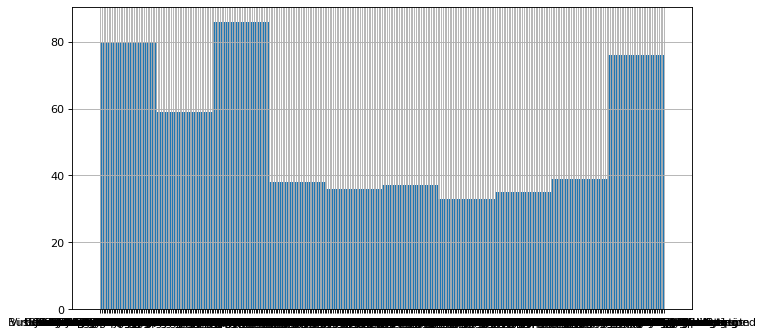

In [19]:
fig = plt.figure(figsize=(10, 5), dpi= 80, facecolor='w', edgecolor='k')
raw.position.hist()

In [20]:
raw['position'].unique()

array(['Account Executive ', 'Business Development Associate ',
       'Key Account Manager ', 'VR Background Actor ',
       'Sales Intelligence Associate ', 'Junior IT Manager ',
       'Legal Counsel ', 'Customer Success Associate',
       'Customer Success Associate ', 'Customer Success Manager',
       'Customer Success Manager ', 'Project Manager ', 'Art Manager ',
       'Senior 3D Artist ', 'Junior Unreal Engine Developer ',
       'Lead Unreal Engine Developer ', 'Senior Unreal Engine Developer ',
       'Unreal Engine Developer - Blueprints ',
       'Associate Designer - AR/VR ', 'Junior Designer - AR/VR ',
       'Senior Designer - AR/VR ', 'Junior Producer ', 'Producer ',
       'Production Assistant ', 'Senior Producer ', 'AR Programmer ',
       'Senior Backend Engineer ', 'Senior DevOps Engineer ',
       'Senior Frontend Engineer ',
       'Senior Unreal Engineer - Augmented Reality ',
       'Technical Director - Content Creation ',
       'Technical Director - VR Sof

In [23]:
## Lower case
clean_raw['jobDescription'] = clean_raw['jobDescription'].apply(lambda x: " ".join(x.lower()for x in x.split()))
## remove tabulation and punctuation
clean_raw['jobDescription'] = clean_raw['jobDescription'].str.replace('[^\w\s]',' ')
## digits
clean_raw['jobDescription'] = clean_raw['jobDescription'].str.replace('\d+', '')

#remove stop words
stop = stopwords.words('english')
clean_raw['jobDescription'] = clean_raw['jobDescription'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

## lemmatization
clean_raw['jobDescription'] = clean_raw['jobDescription'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

print("Preprocessed data: \n")
print(clean_raw.head())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: ht

Preprocessed data: 

                          position                                     jobDescription
0               Account Executive   responsibility stimulate revenue growth europe...
1               Account Executive   responsibility stimulate revenue growth europe...
2               Account Executive   responsibility stimulate revenue growth europe...
3  Business Development Associate   responsibility communicate client represent re...
4  Business Development Associate   responsibility communicate client represent re...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]


In [24]:
clean_raw.tail()


,position,jobDescription
514,Senior Product Manager,ideal candidate people oriented passionate eco...
515,"Director, Product Marketing",develop conduct launch complex go market campa...
516,"Director, Product Marketing",develop conduct launch complex go market campa...
517,"Director, Product Marketing",develop conduct launch complex go market campa...
518,"Director, Product Marketing",develop conduct launch complex go market campa...


In [26]:
## jda stands for job description aggregated
jda = clean_raw.groupby(['position']).sum().reset_index()
print("Aggregated job descriptions: \n")
print(jda)

Aggregated job descriptions: 

                                              position                                     jobDescription
0                  Backend Engineer  - C# / .NET Core   responsibility duty design build scalable ente...
1                             Backend Engineer - Java   responsibility duty help design build scalable...
2                         Backend Engineer - Node.js    responsibility duty architect implement mainta...
3                            Backend Engineer - Python  responsibility duty architect build web platfo...
4                             Backend Engineer - Ruby   responsibility duty architect build web applic...
..                                                 ...                                                ...
318                         User Experience Researcher  work directly product design business marketin...
319                                    User Researcher  role plan execute varied study interview sessi...
320            

# **Visualizing data**
## *WordClouds*


***  Backend Engineer  - C# / .NET Core  ***



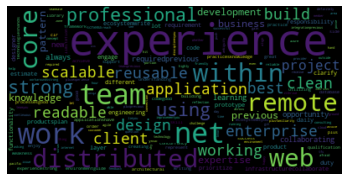


***  Backend Engineer - Java  ***



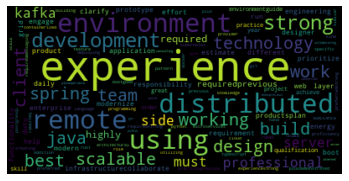


***  Backend Engineer - Node.js   ***



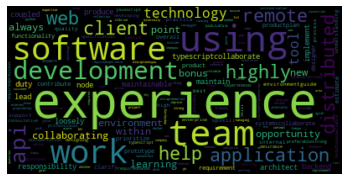


***  Backend Engineer - Python ***



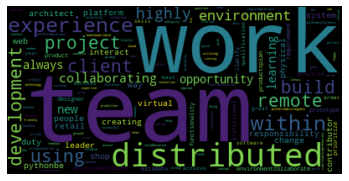


***  Backend Engineer - Ruby  ***



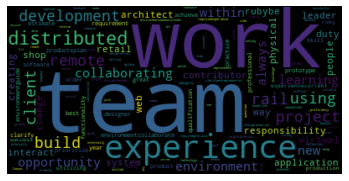


***  Frontend Engineer - React  ***



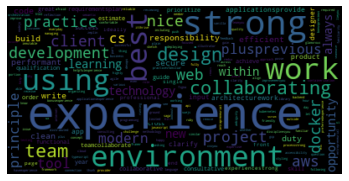


***  Full Stack Engineer  ***



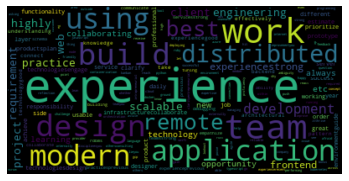


***  Quality Assurance Engineer ***



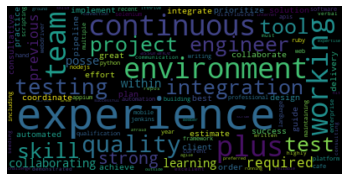


*** AR Programmer  ***



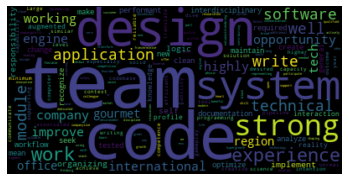


*** Account Executive  ***



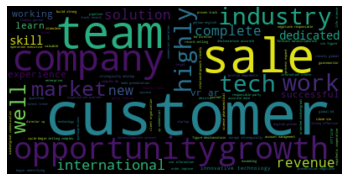


*** Account Executive, Growth ***



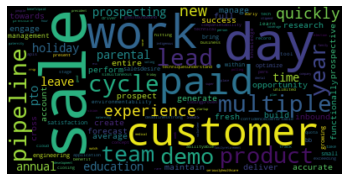


*** Account Manager  - Indiana Real Estate License Required ***



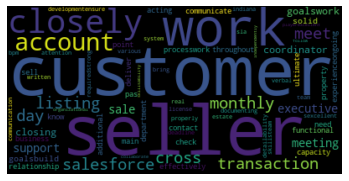


*** Accounting Manager ***



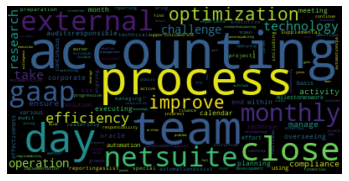


*** Accounts Executive ***



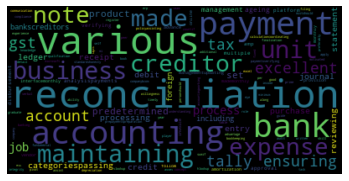


*** Application Security Engineer ***



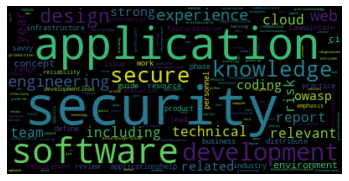


*** Art Manager  ***



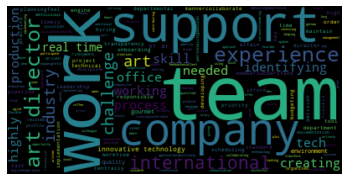


*** Asset Management Analyst ***



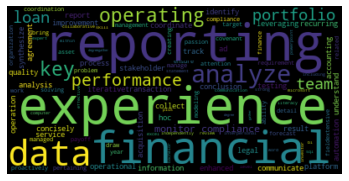


*** Asset Management Associate ***



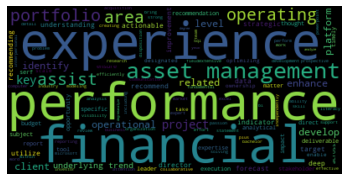


*** Associate - System Support and Process Design ***



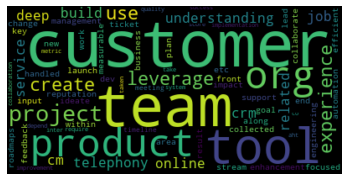


*** Associate Business Development Manager - UK based  ***



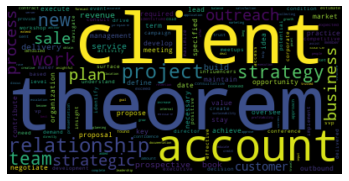


*** Associate Designer - AR/VR  ***



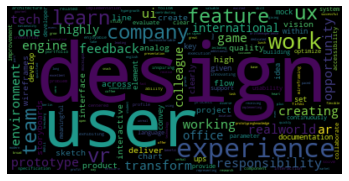


*** Associate Director, Product Management ***



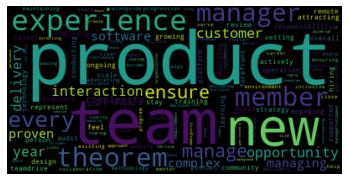


*** Associate Product Manager  ***



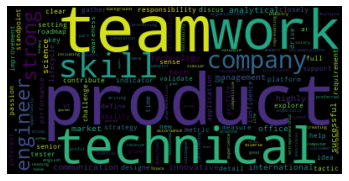


*** BE Developer  ***



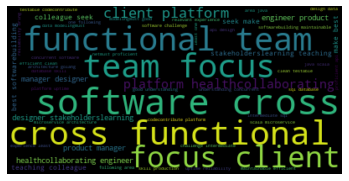


*** Backend Engineer - Connectivity ***



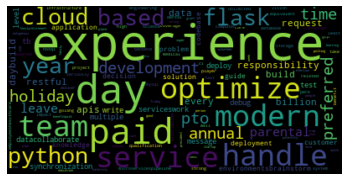


*** Banking Operations Associate ***



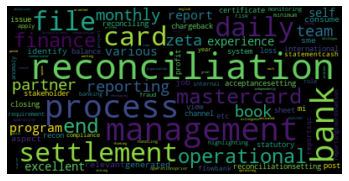


*** Business Analyst  ***



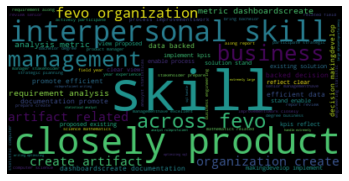


*** Business Development Associate  ***



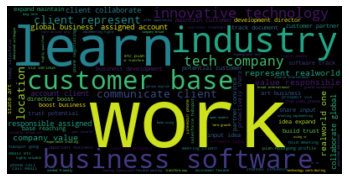


*** Business Development Manager - Americas Focused  ***



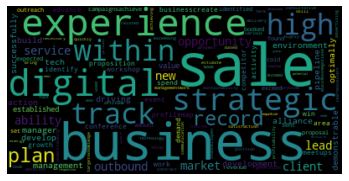


*** Business Development Representative ***



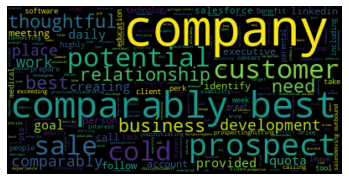


*** Cloud Infrastructure Engineering Manager ***



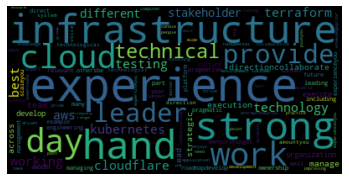


*** Commercial Account Executive ***



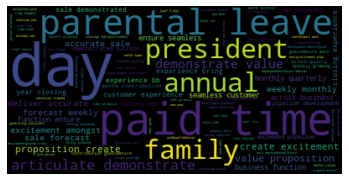


*** Construction Coordinator ***



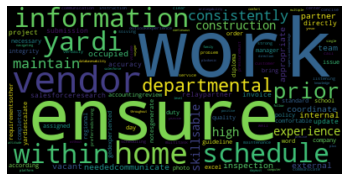


*** Construction Manager ***



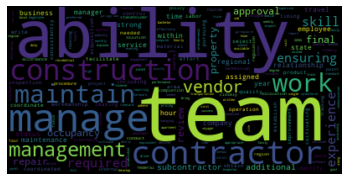


*** Content Marketing Manager ***



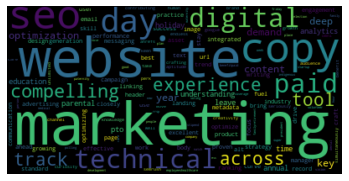


*** Content Marketing Specialist ***



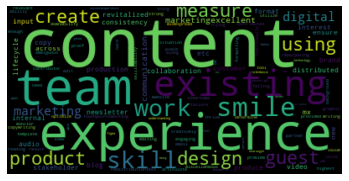


*** Core Infrastructure Engineer ***



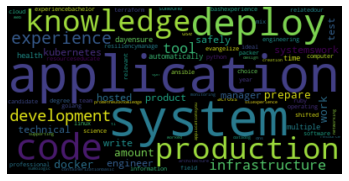


*** Counsel, Property Management ***



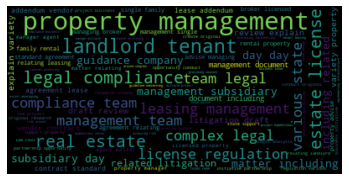


*** Customer Success Associate ***



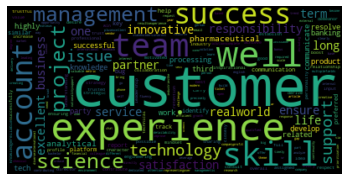


*** Customer Success Associate  ***



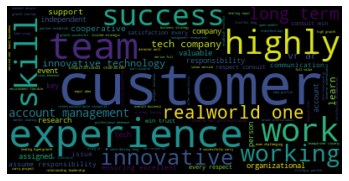


*** Customer Success Manager ***



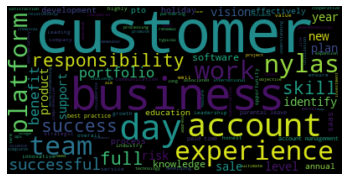


*** Customer Success Manager  ***



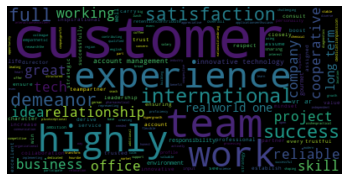


*** Customer Success Representative ***



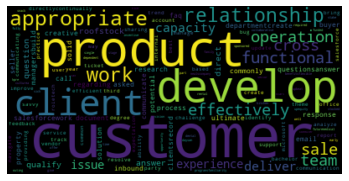


*** Data Analyst  ***



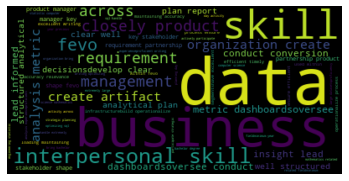


*** Data Engineer ***



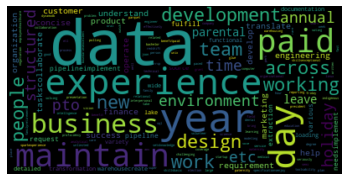


*** Data Scientist  ***



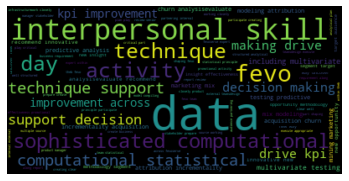


*** Database Administrator ***



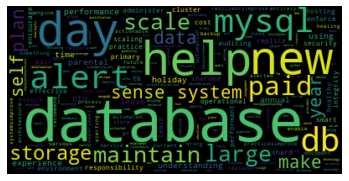


*** Database Administrator I ***



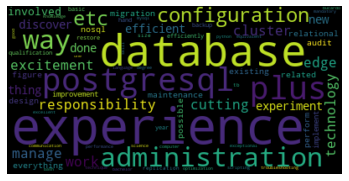


*** Database Specialist ***



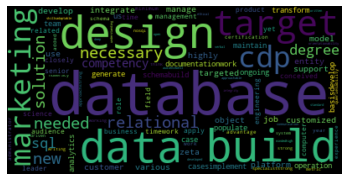


*** Dev Ops Engineer  ***



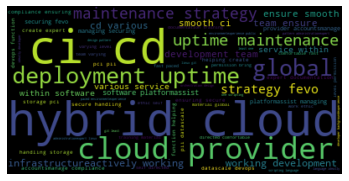


*** DevOps Engineer II - Banking Payments ***



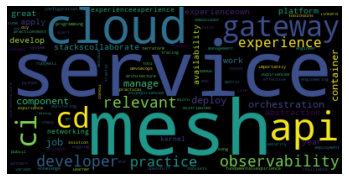


*** DevOps Engineer II - Banking SAAS ***



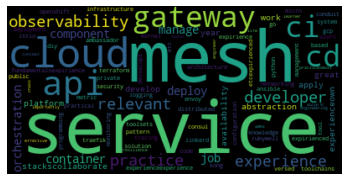


*** Developer Advocate ***



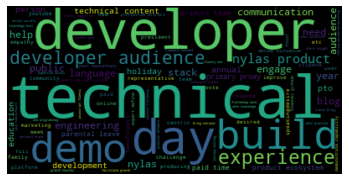


*** Developer Relations ***



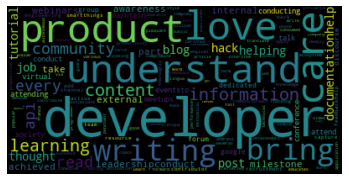


*** Digital Growth Hacker / Social Media Strategist  ***



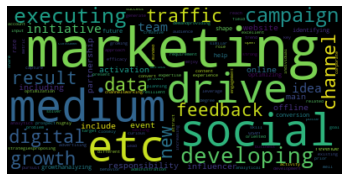


*** Digital Product Designer  ***



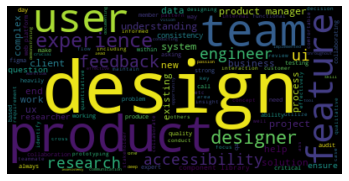


*** Director of Product ***



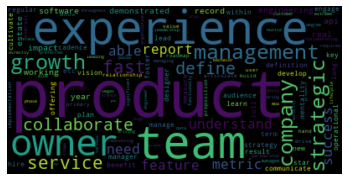


*** Director of Sales - Real Estate  ***



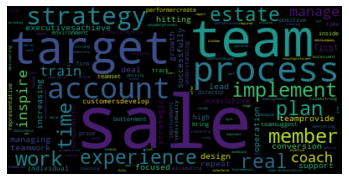


*** Director, Developer Relations ***



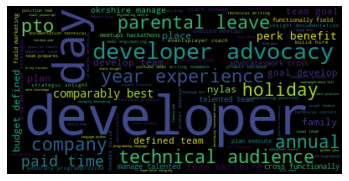


*** Director, Product Marketing  ***



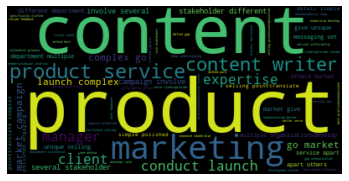


*** Documentation Engineer ***



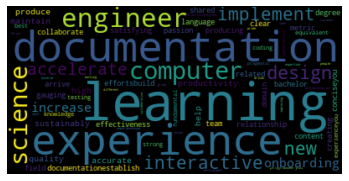


*** Engineering Manager ***



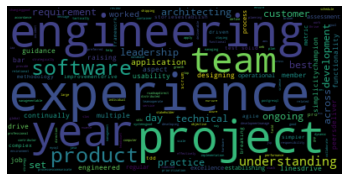


*** Engineering Manager  ***



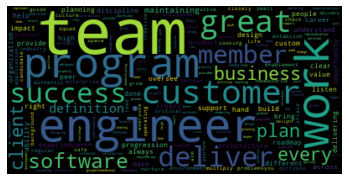


*** Engineering Manager - Intelligence ***



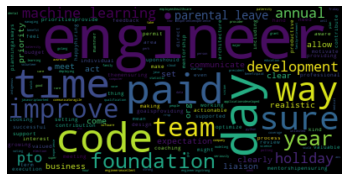


*** Engineering Manager, Developer Experience ***



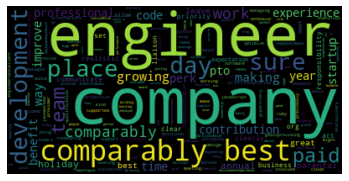


*** Engineering Talent Advocate  ***



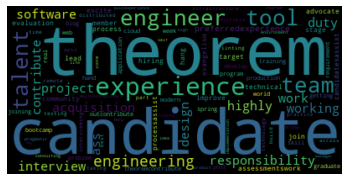


*** Enterprise Account Executive ***



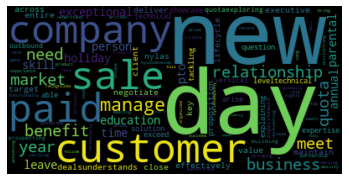


*** Executive Assistant to the COO ***



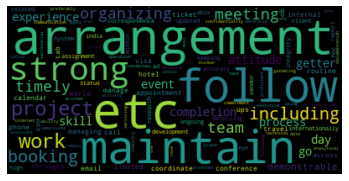


*** Experience Manager  ***



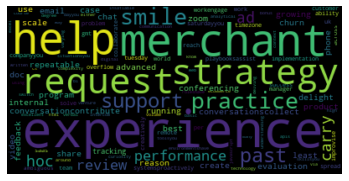


*** FE Developer  ***



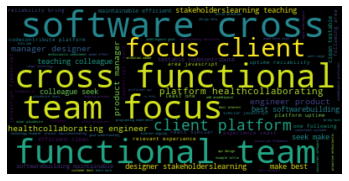


*** Field Marketing Manager ***



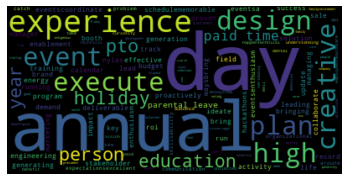


*** Fraud Operations Coordinator ***



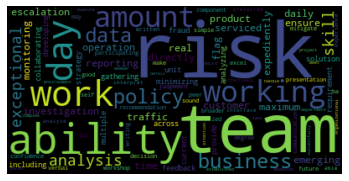


*** Full Stack Developer  ***



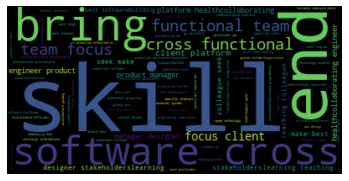


*** Full-Stack Engineer ***



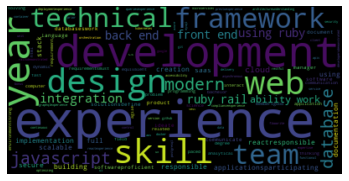


*** Growth Account Executive ***



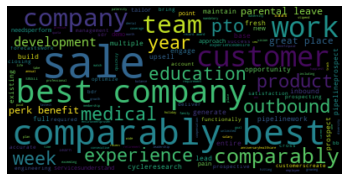


*** HR Generalist ***



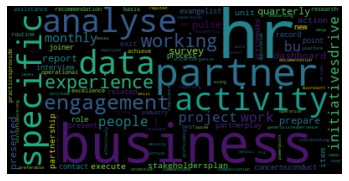


*** Head - Total Rewards, Wellness and Analytics ***



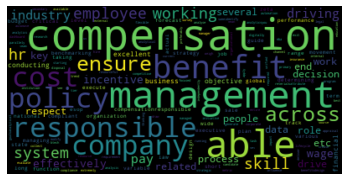


*** Head of Product  ***



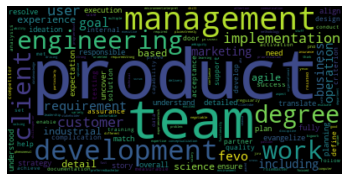


*** Human Resource Business Partner ***



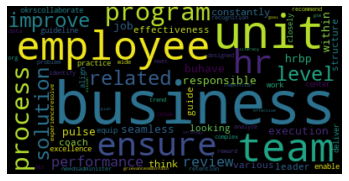


*** Human Resource Business Partner- Engineering ***



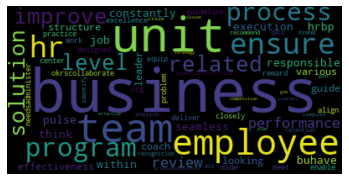


*** IT Manager ***



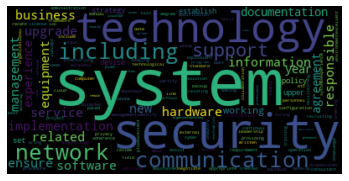


*** IT Support Specialist ***



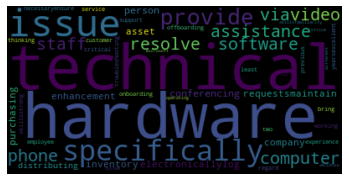


*** Implementation Engineer ***



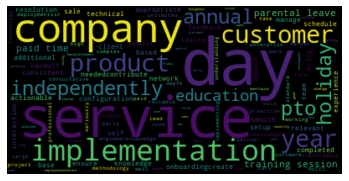


*** Implementation Specialist ***



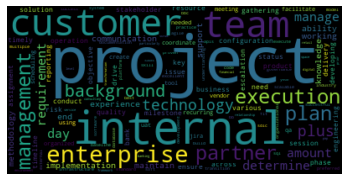


*** Information Developer ***



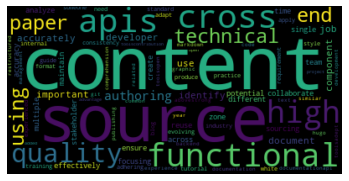


*** Information Security Engineer ***



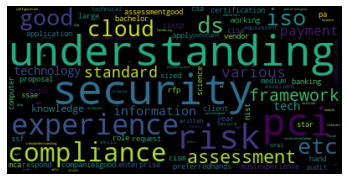


*** Intern - Human Resource ***



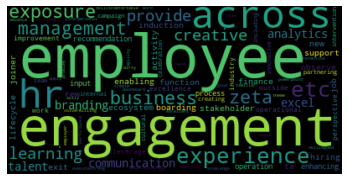


*** Intern - Video Editor ***



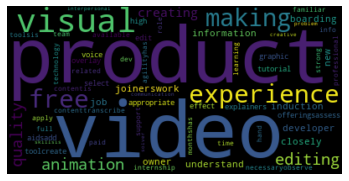


*** Internal Communications Manager ***



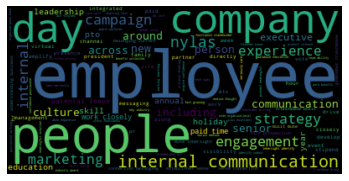


*** Investment Analyst ***



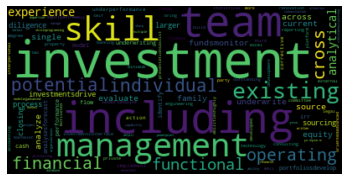


*** Junior Designer - AR/VR  ***



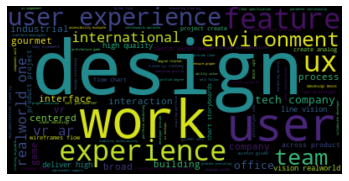


*** Junior IT Manager  ***



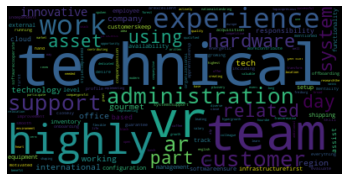


*** Junior Producer  ***



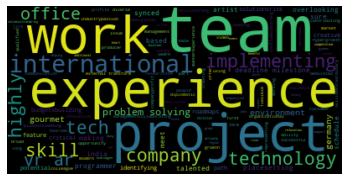


*** Junior QA Tester  ***



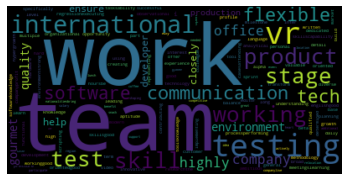


*** Junior Unreal Engine Developer  ***



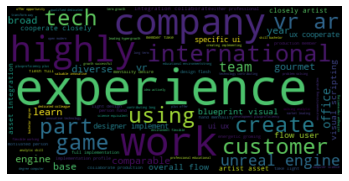


*** Key Account Manager  ***



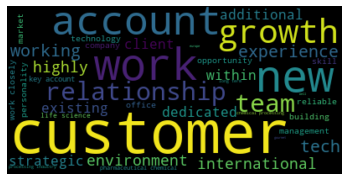


*** Lead - React Native ***



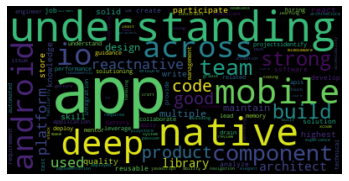


*** Lead DevOps Engineer - Ops Infra ***



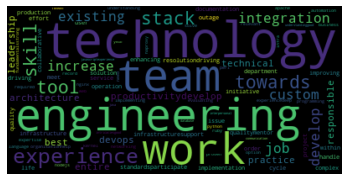


*** Lead Software Development Engineer - Frontend - Enterprise Payments ***



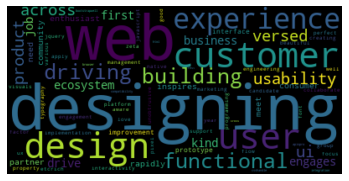


*** Lead Software Development Engineer in Test - Banking Saas ***



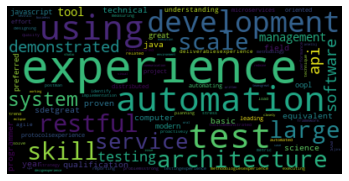


*** Lead Software Development Engineer- Android ***



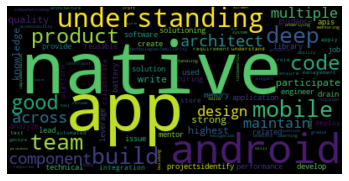


*** Lead Software Development Engineer- iOS ***



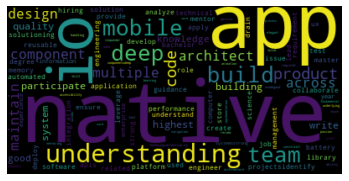


*** Lead Software Engineer - Fullstack  ***



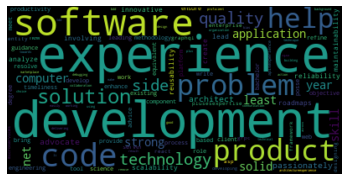


*** Lead Software Engineer Frontend - Luminous ***



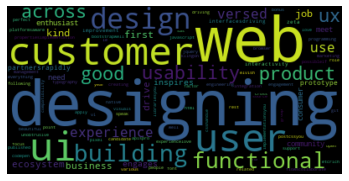


*** Lead Unreal Engine Developer  ***



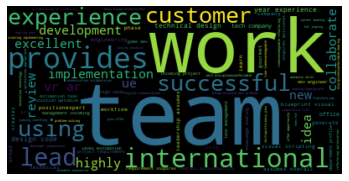


*** Learning & Development Intern ***



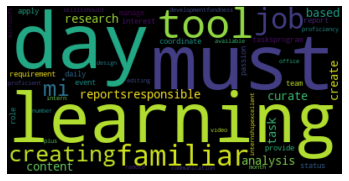


*** Learning and Development Specialist ***



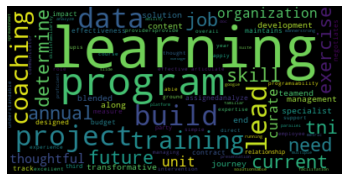


*** Legal Counsel  ***



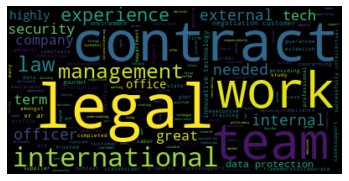


*** Maintenance Technician ***



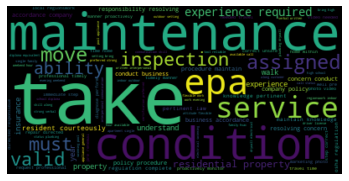


*** Manager - Portfolio Operations ***



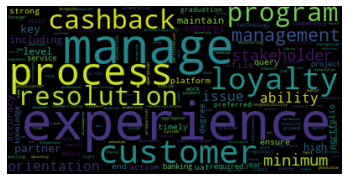


*** Manager - Pre-Issuing Operations ***



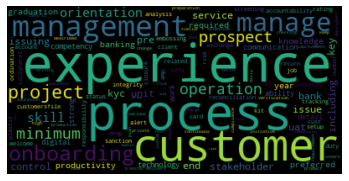


*** Manager - Settlement Operations ***



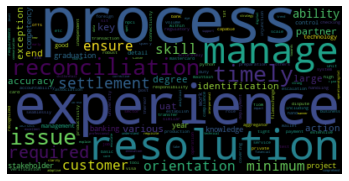


*** Manager Software Development Engineer- Frontend  ***



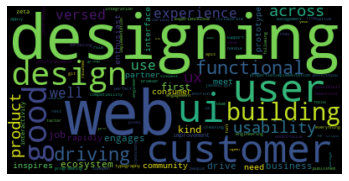


*** Manager Software Development-Mobile-Banking Saas ***



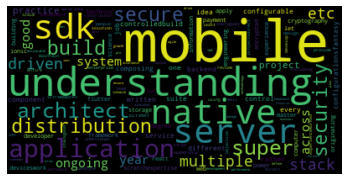


*** Manager, Recruiting ***



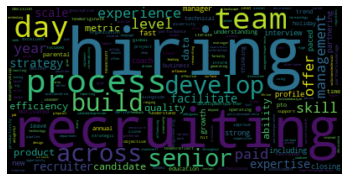


*** Manager, Recruiting  ***



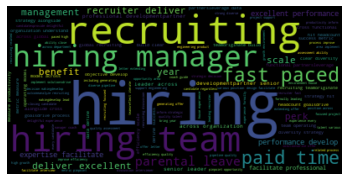


*** Manager, Technical Support Engineering ***



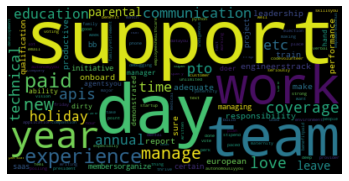


*** Manager, Workplace & Events ***



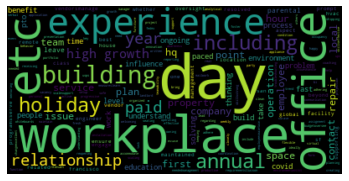


*** Marketing Automation Manager ***



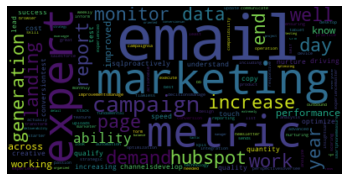


*** Marketing Intern ***



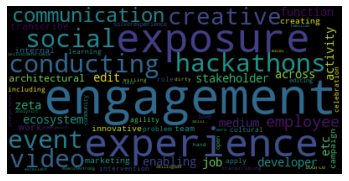


*** Marketing Manager, Demand Generation ***



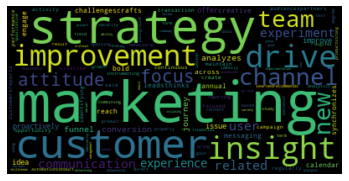


*** Marketing Operations Associate ***



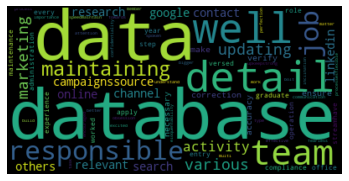


*** Marketing Operations Specialist ***



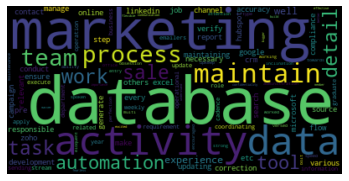


*** Marketing and Design Coordinator ***



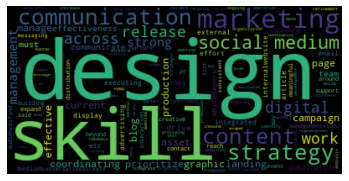


*** Office Manager  ***



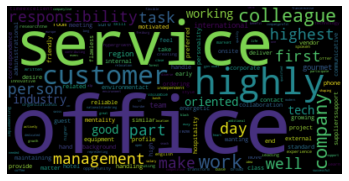


*** Organizational Agile Coach - NYC ***



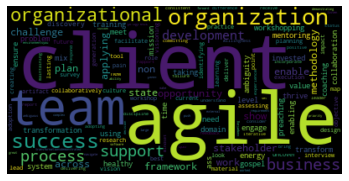


*** Payroll Manager ***



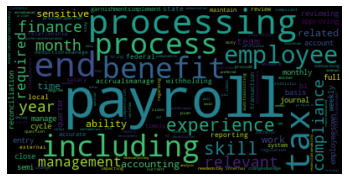


*** People & Talent Development Manager  ***



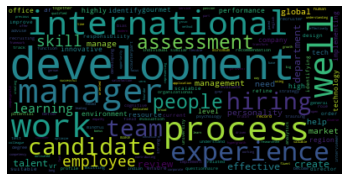


*** People Partner ***



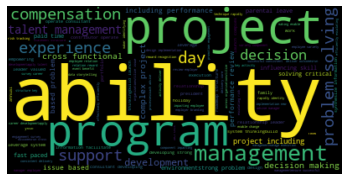


*** Principal DevOps Engineer Ops Infra ***



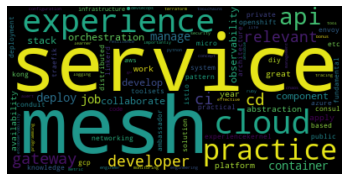


*** Principal Engineer ***



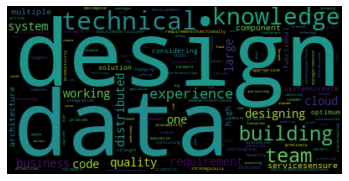


*** Principal Engineer - Banking Payments ***



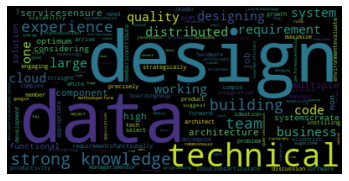


*** Privacy Engineer/ Privacy Counsel ***



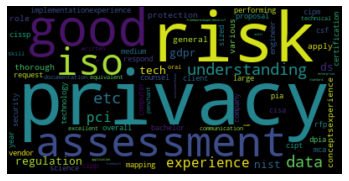


*** Process Coach ***



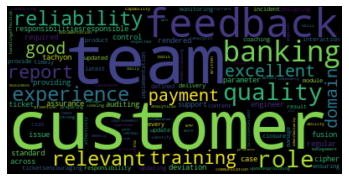


*** Producer  ***



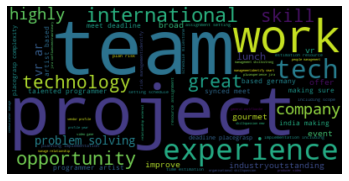


*** Product Analyst ***



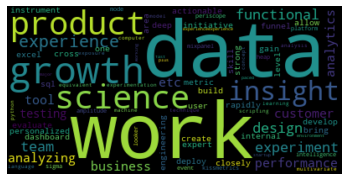


*** Product Analyst   ***



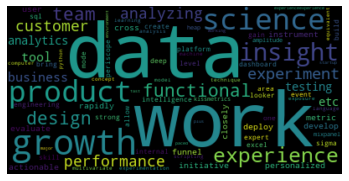


*** Product Design Director ***



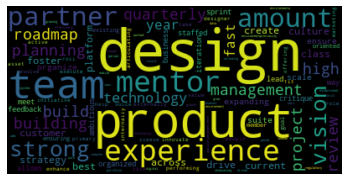


*** Product Design Talent Advocate  ***



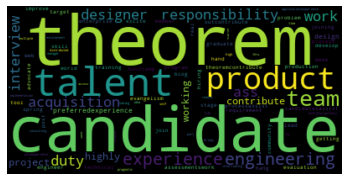


*** Product Designer  ***



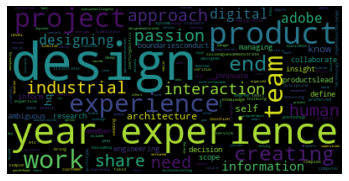


*** Product Engineering Strategist  ***



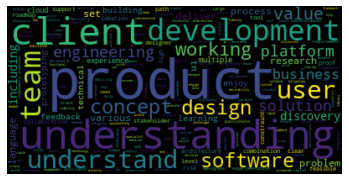


*** Product Manager  ***



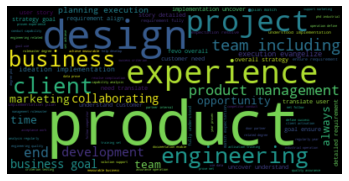


*** Product Manager - Aura ***



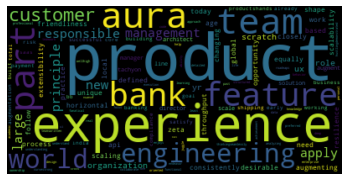


*** Product Manager - Data Science ***



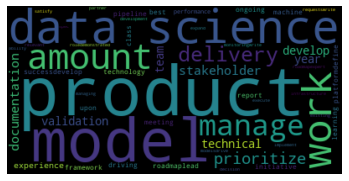


*** Product Manager - Electron ***



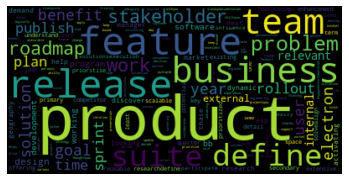


*** Product Manager - Electron Rewards ***



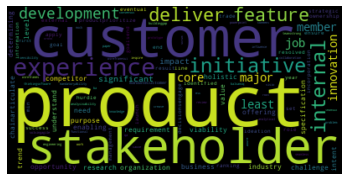


*** Product Manager - Infrastructure & Engineering Services ***



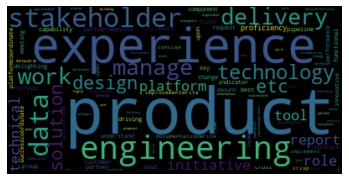


*** Product Manager - Luminos ***



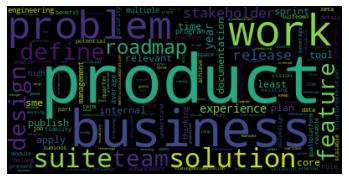


*** Product Manager - Olympus ***



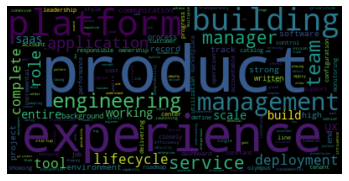


*** Product Manager - Platform ***



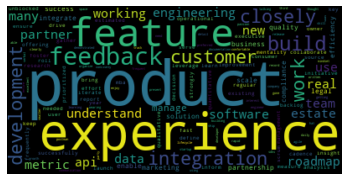


*** Product Manager - Plutus ***



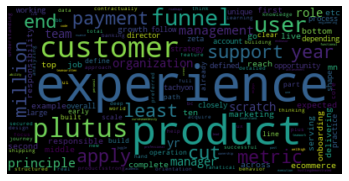


*** Product Manager - Product Analytics ***



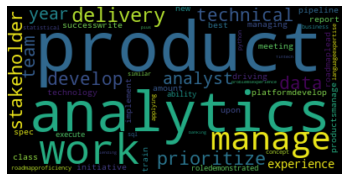


*** Product Manager - Product Success ***



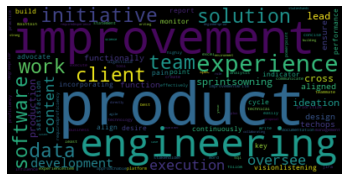


*** Product Manager / Senior Product Manager - Axon ***



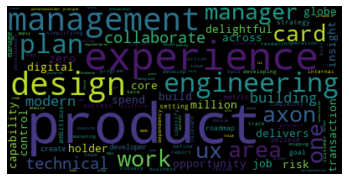


*** Product Manager / Senior Product Manager - Cipher ***



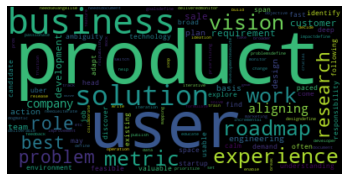


*** Product Marketing Manager ***



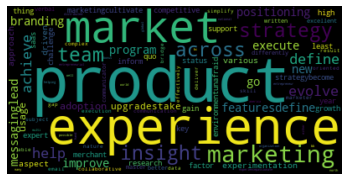


*** Product Strategist - Discovery  ***



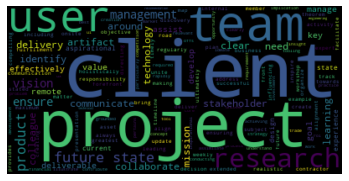


*** Product Support Technical Lead ***



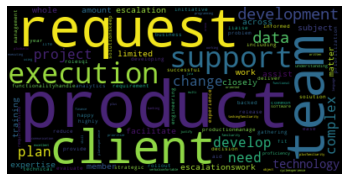


*** Production Assistant  ***



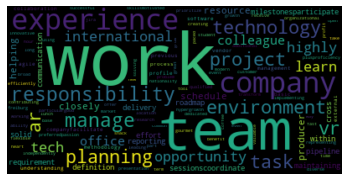


*** Program Director, Custom Software  ***



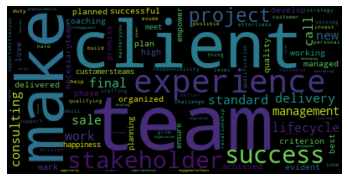


*** Program Manager ***



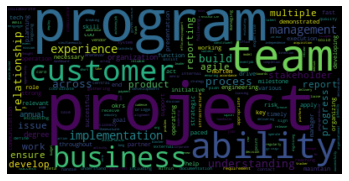


*** Project Coordinator ***



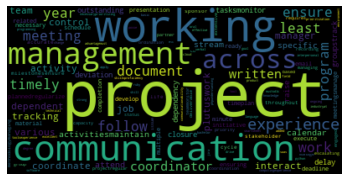


*** Project Manager ***



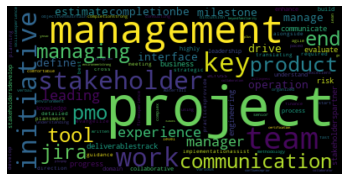


*** Project Manager  ***



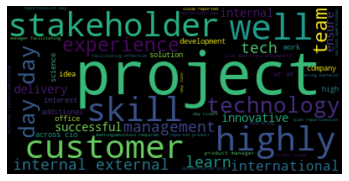


*** Project Manager - Banking Network ***



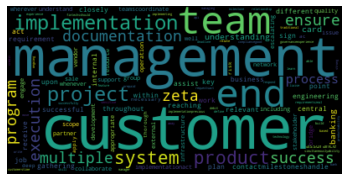


*** Project Manager - Sales Team ***



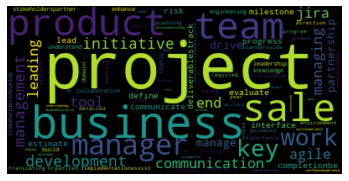


*** Property Accountant ***



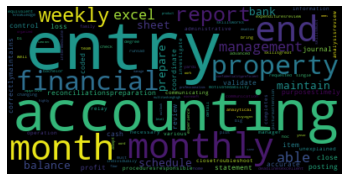


*** Property Accountant - Temp to Hire ***



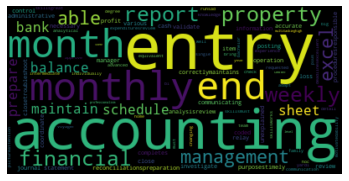


*** Property Manager - Birmingham ***



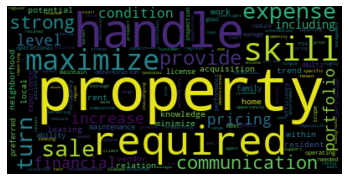


*** Property Manager - Houston ***



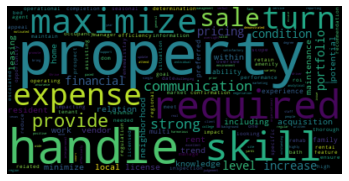


*** Property Manager - Indianapolis ***



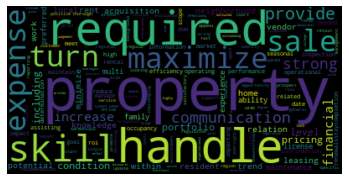


*** Property Manager - Jacksonville ***



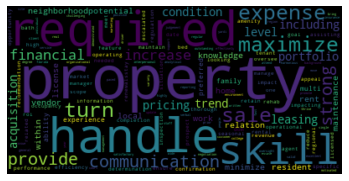


*** QA Test Manager  ***



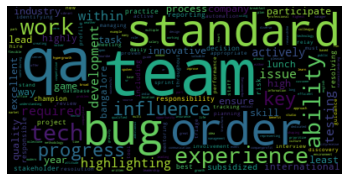


*** Quality Engineer ***



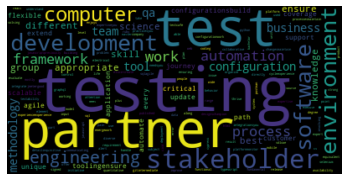


*** Real Estate Analyst ***



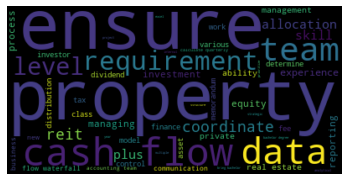


*** Resident Coordinator ***



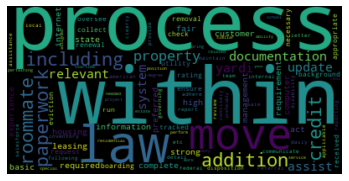


*** Residential Construction Superintendent ***



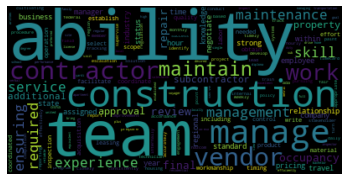


*** SDR - Sales Development Representative  ***



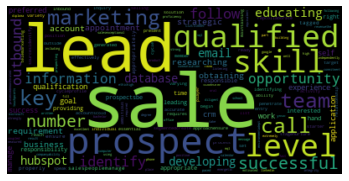


*** SDR - Sales Development Representative , based in Germany ***



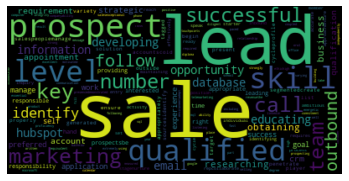


*** SDR - Sales Development Representative , based in United Kingdom ***



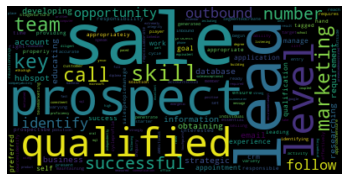


*** Sales Development Representative ***



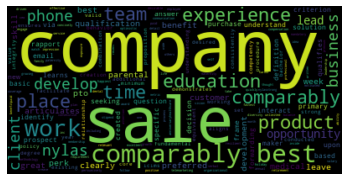


*** Sales Intelligence Associate  ***



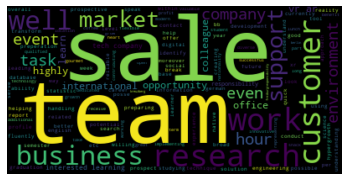


*** Sales Onboarding & Training Specialist ***



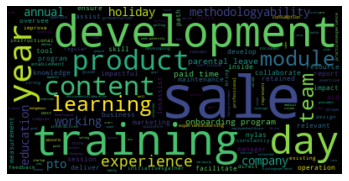


*** Scheduling Coordinator - Construction ***



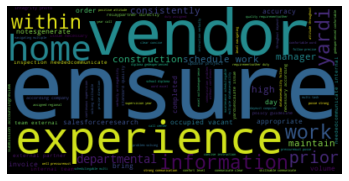


*** Scrum Master ***



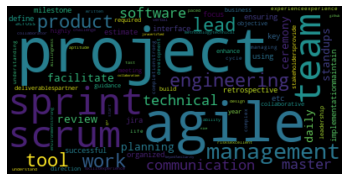


*** Scrum Master - Partner Engineering ***



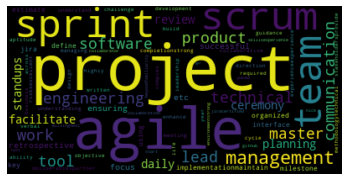


*** Security Operations Analyst  ***



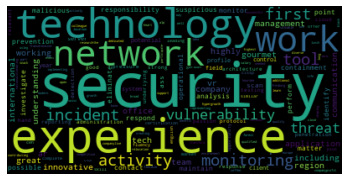


*** Security Operations Manager ***



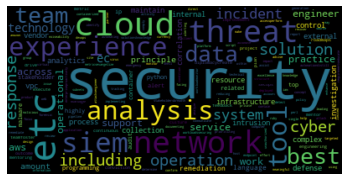


*** Senior 3D Artist  ***



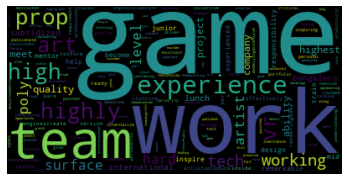


*** Senior Accountant ***



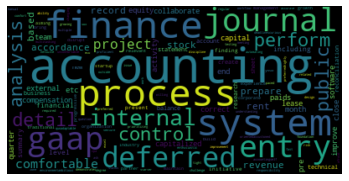


*** Senior Backend Engineer  ***



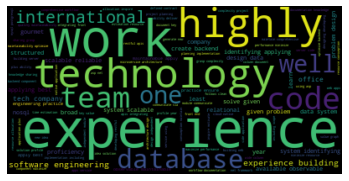


*** Senior Backend Engineer - Connectivity ***



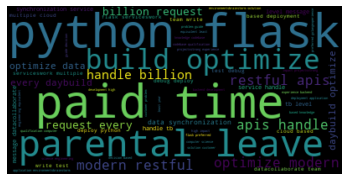


*** Senior Brand Designer ***



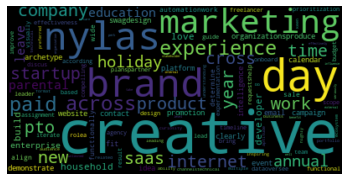


*** Senior Campaign Manager ***



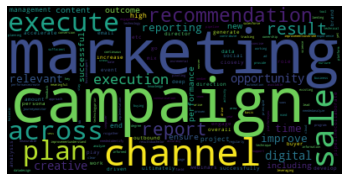


*** Senior Data Engineer ***



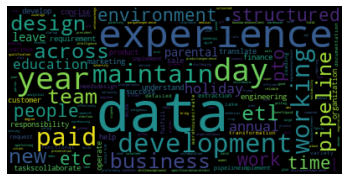


*** Senior Designer - AR/VR  ***



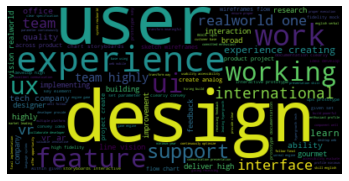


*** Senior DevOps Engineer ***



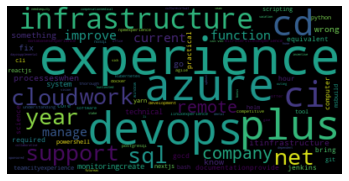


*** Senior DevOps Engineer  ***



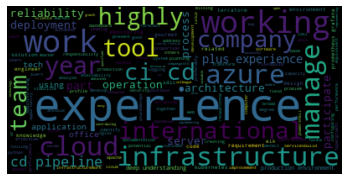


*** Senior DevOps Engineer - Banking ***



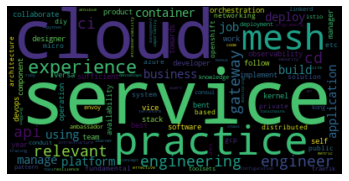


*** Senior Engineer - Intelligence ***



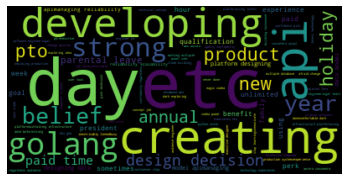


*** Senior Financial Analyst ***



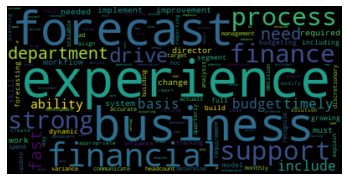


*** Senior Front End Software Engineer ***



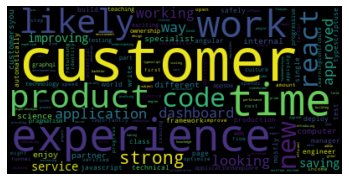


*** Senior Frontend Engineer  ***



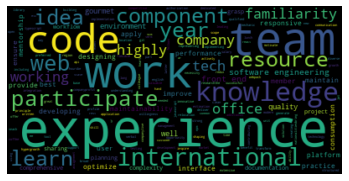


*** Senior Frontend/Full Stack Engineer ***



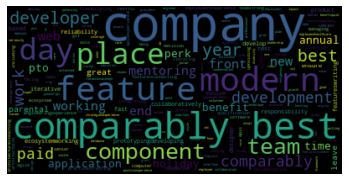


*** Senior Full Stack Software Engineer  ***



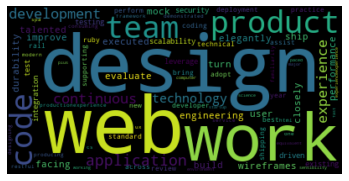


*** Senior Full Stack Software Engineer   ***



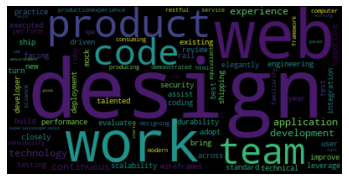


*** Senior Full-Stack Engineer ***



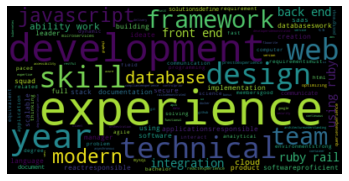


*** Senior Incident Commander ***



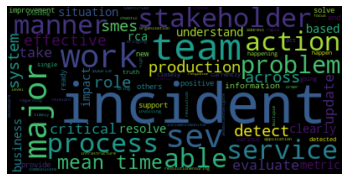


*** Senior Incident Commander* ***



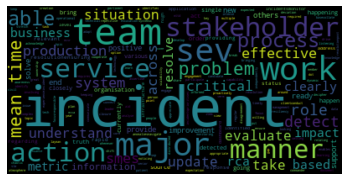


*** Senior Machine Learning Engineer - NLP ***



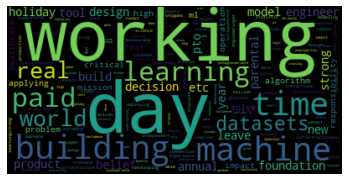


*** Senior Manager - Customer Lifecycle and Experience ***



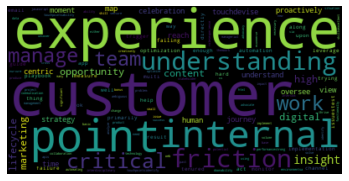


*** Senior Manager, Product Management ***



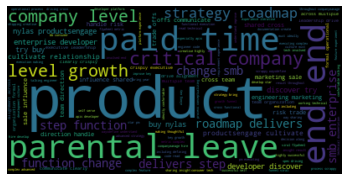


*** Senior Platform Engineer ***



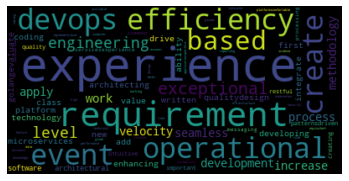


*** Senior Producer  ***



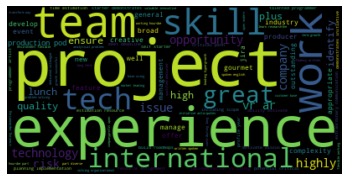


*** Senior Product Designer ***



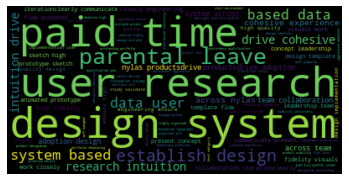


*** Senior Product Manager ***



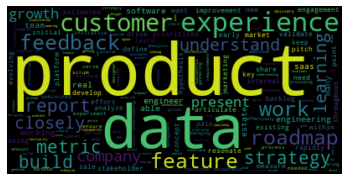


*** Senior Product Manager  ***



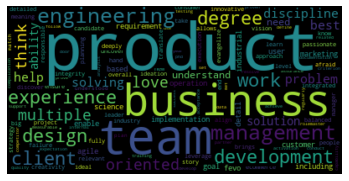


*** Senior Product Managers ***



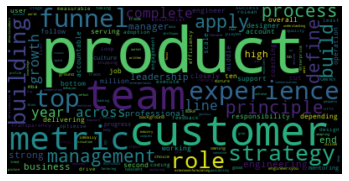


*** Senior Product Support Analyst ***



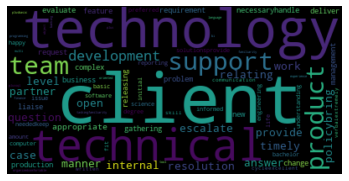


*** Senior QA Tester - Gaming / VR  ***



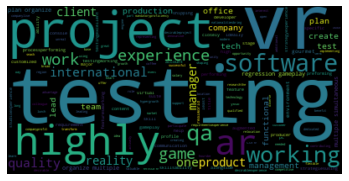


*** Senior SDE - Backend - Axon ***



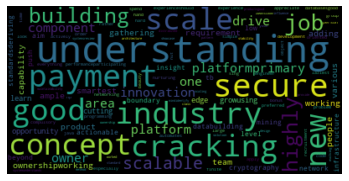


*** Senior Salesforce Administrator  ***



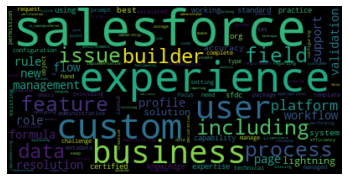


*** Senior Site Reliability Engineer ***



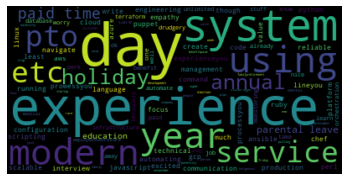


*** Senior Software Developer in Test ***



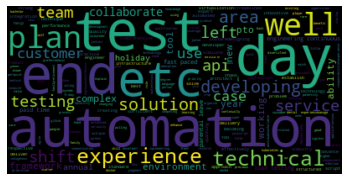


*** Senior Software Development Engineer  ***



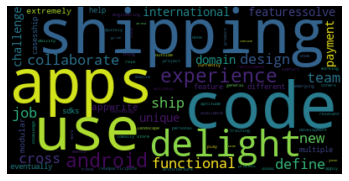


*** Senior Software Development Engineer - Backend - Enterprise Payments ***



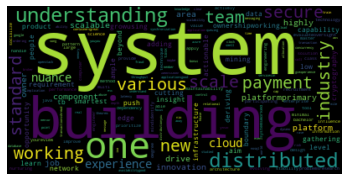


*** Senior Software Development Engineer - Frontend ***



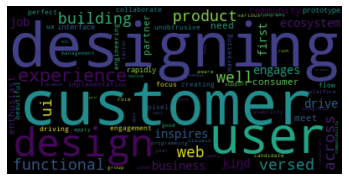


*** Senior Software Development Engineer - Frontend - AXON ***



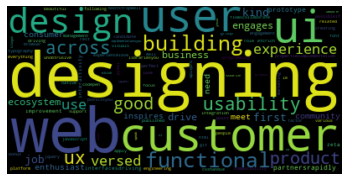


*** Senior Software Development Engineer - Frontend-Banking Saas ***



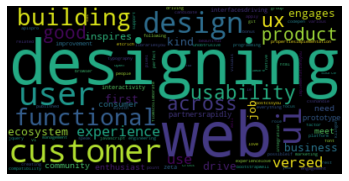


*** Senior Software Development Engineer - Payments ***



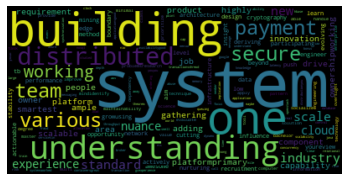


*** Senior Software Development Engineer -iOS ***



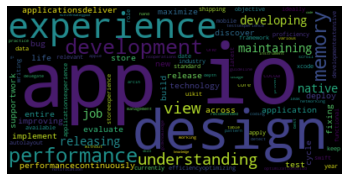


*** Senior Software Engineer ***



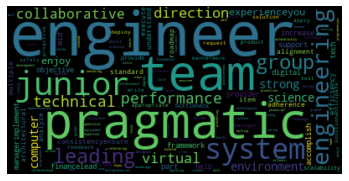


*** Senior Software Engineer - Custom Features ***



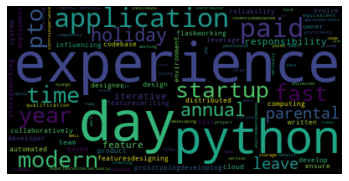


*** Senior Software Engineer - Features ***



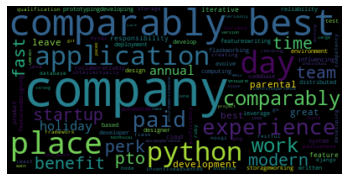


*** Senior Software Engineer - Platforms ***



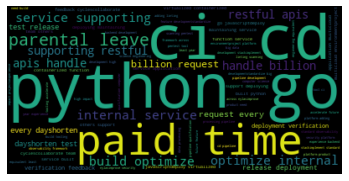


*** Senior Technical Program Manager ***



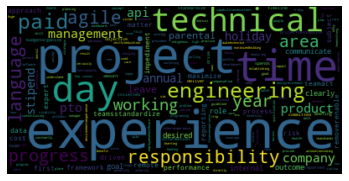


*** Senior Technical Recruiter ***



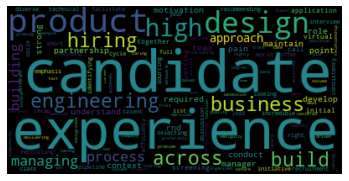


*** Senior Technical Support Engineer - Escalations ***



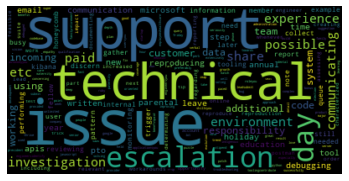


*** Senior UI/UX React Developer ***



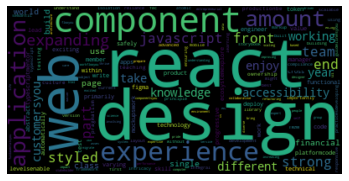


*** Senior UX Designer ***



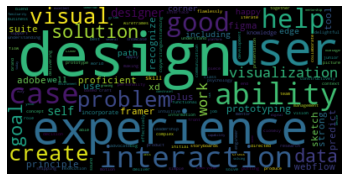


*** Senior Unreal Engine Developer  ***



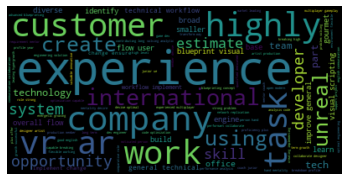


*** Senior Unreal Engineer - Augmented Reality  ***



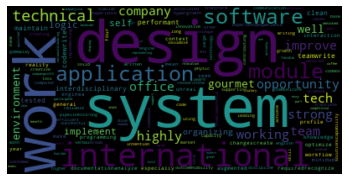


*** Senior/Marketing Manager ***



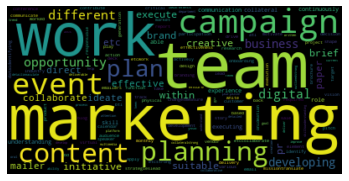


*** Site Reliability Engineer ***



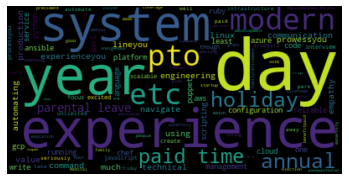


*** Site Reliability Engineer @ Apple  ***



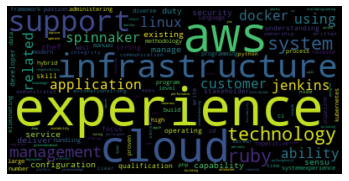


*** Social Media and Content Strategy Manager ***



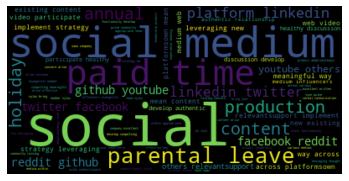


*** Software Developer in Test ***



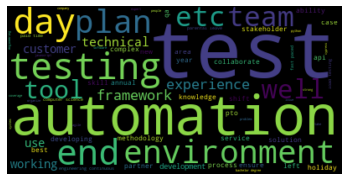


*** Software Development Engineer Android - Luminous ***



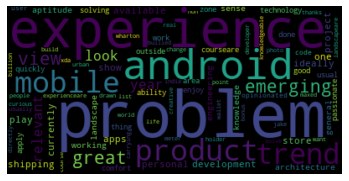


*** Software Development Engineer Android - Payments ***



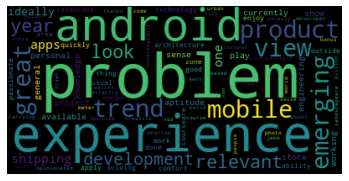


*** Software Development Engineer II  ***



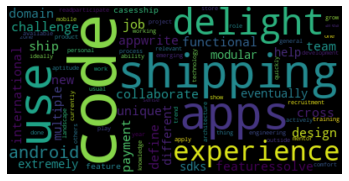


*** Software Development Engineer II - React Native ***



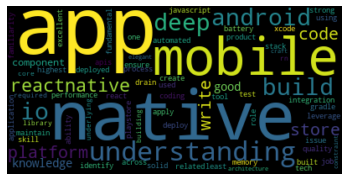


*** Software Development Engineer II- iOS ***



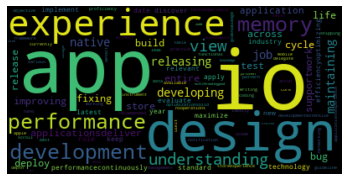


*** Software Development Engineer iOS - Luminous ***



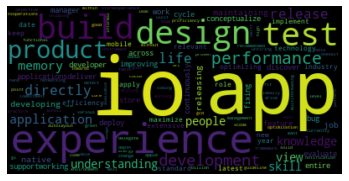


*** Software Development Engineer iOS - Payments ***



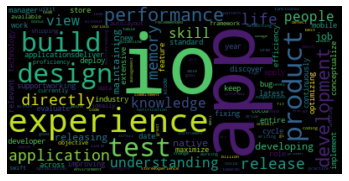


*** Software Engineer - Custom Features ***



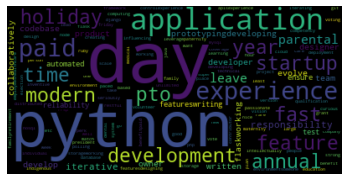


*** Software Engineer - Features ***



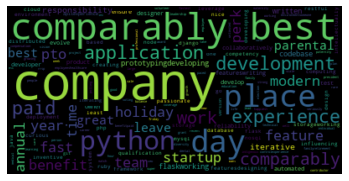


*** Software Engineer, Content ***



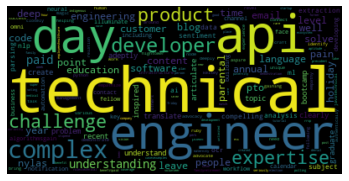


*** Software Engineering Manager ***



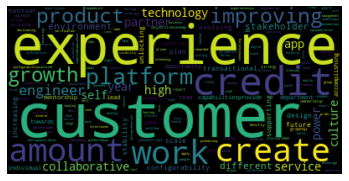


*** Solution Architect - Banking ***



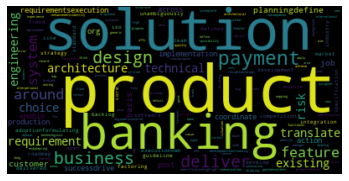


*** Solution Architect - Cards and Payment ***



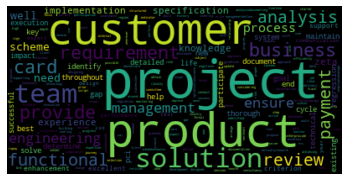


*** Solution Architect - Electron ***



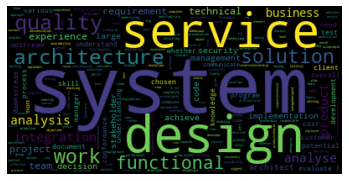


*** Solutions Engineer II ***



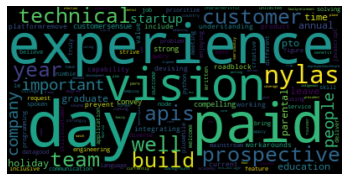


*** Sr DevOps Engineer - Axon ***



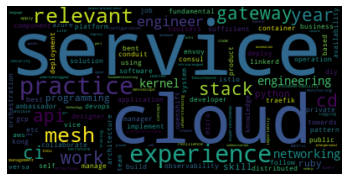


*** Sr DevOps Engineer - Enterprise Payments ***



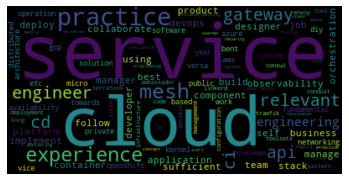


*** Sr DevOps Engineer - Luminous ***



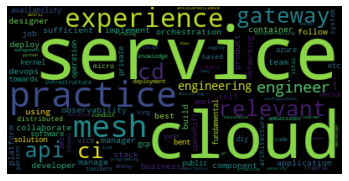


*** Sr DevOps Engineer - Plutus ***



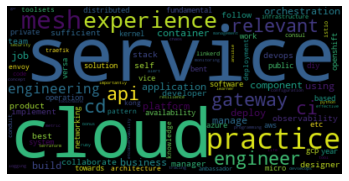


*** Sr Manager, Performance Marketing ***



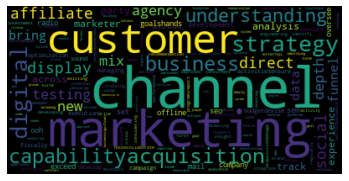


*** Sr Product Manager/Associate Director - Tachyon ***



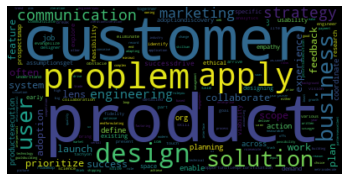


*** Sr Software Development Engineer - Luminous ***



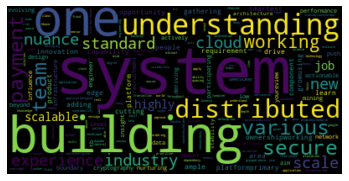


*** Sr Solution Architect ***



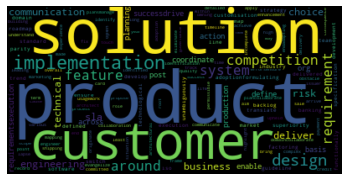


*** Sr. Account Based Marketing Manager ***



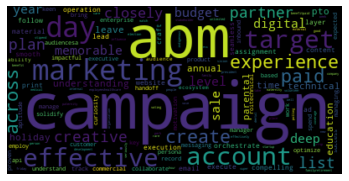


*** Sr. Data Engineer  ***



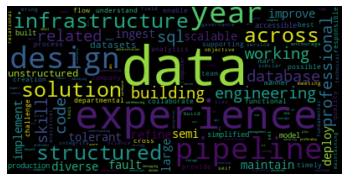


*** Sr. Deal Desk Manager ***



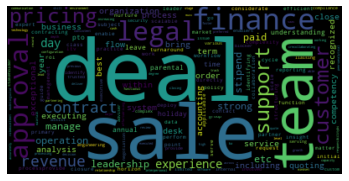


*** Sr. Director, FP&A ***



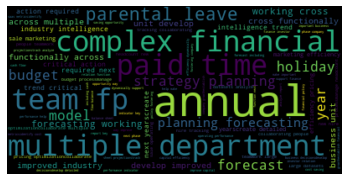


*** Sr. Director, Sales Operations ***



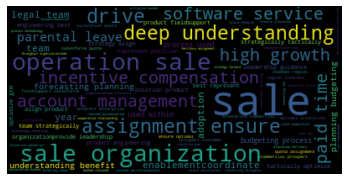


*** Sr. Manager, Product Marketing ***



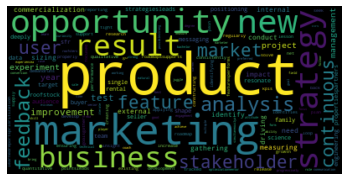


*** Sr. Manager/Manager - Finance & Accounts ***



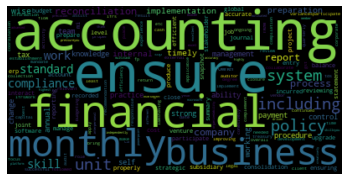


*** Sr. Sales Recruiter ***



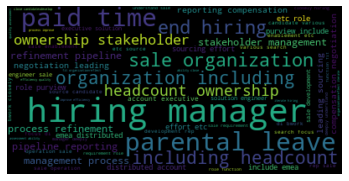


*** Sr. Service Delivery Manager ***



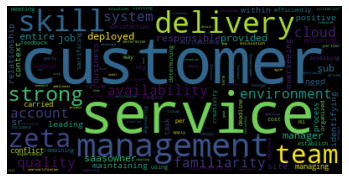


*** Sr. Software Development Engineer - Frontend  - Luminous ***



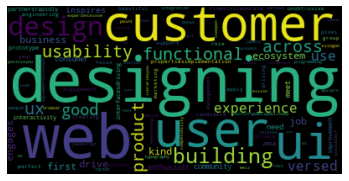


*** Sr. Software Engineer  ***



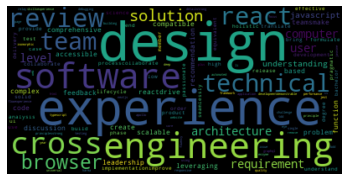


*** Sr. Software Engineer - .NET  ***



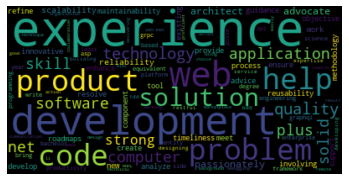


*** Sr. Software Engineer - Salesforce  ***



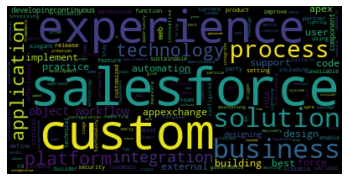


*** Sr. Technical Product Marketing Manager ***



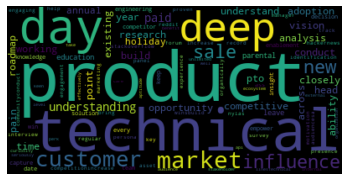


*** Sr. Technical Recruiter ***



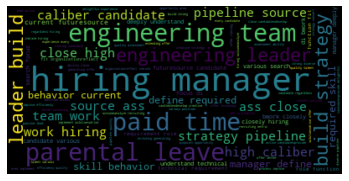


*** Sr.Software Development Engineer - Backend - Banking Saas ***



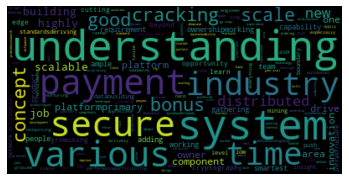


*** Sr.Software Development Engineer in Test- Banking Saas ***



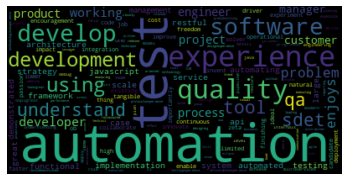


*** Strategic Alliances Manager ***



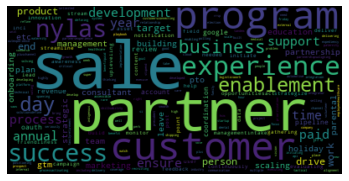


*** Strategic Partnerships Manager ***



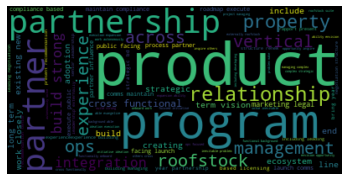


*** System Operations Engineer ***



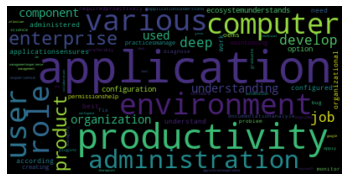


*** Talent Acquisition Intelligence Associate  ***



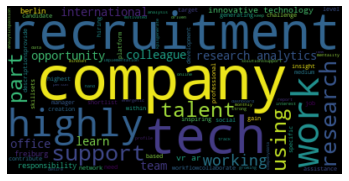


*** Talent Acquisition Intern ***



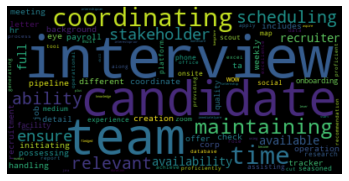


*** Talent Acquisition Representative  ***



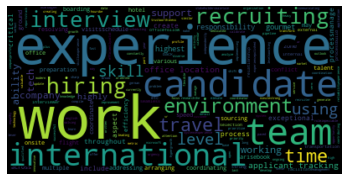


*** Talent Acquisition Specialist ***



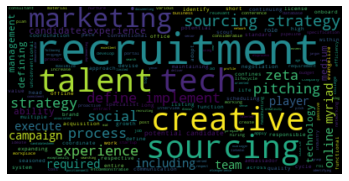


*** TechOps Engineer  ***



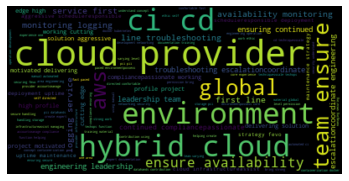


*** Technical Architect ***



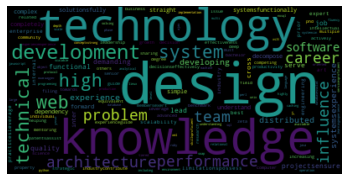


*** Technical Business Analyst ***



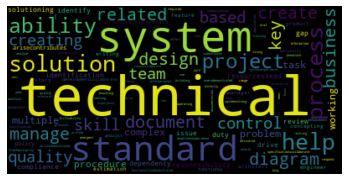


*** Technical Director - Content Creation  ***



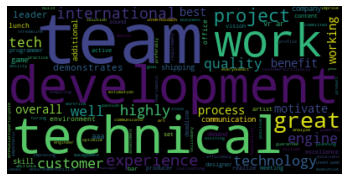


*** Technical Director - VR Software  ***



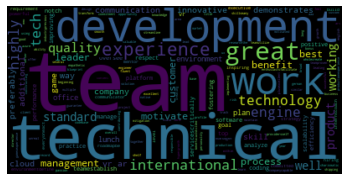


*** Technical Director – Content Creation  ***



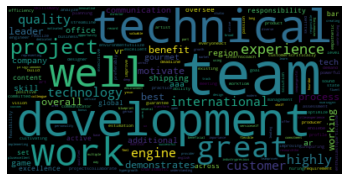


*** Technical Director – VR Software  ***



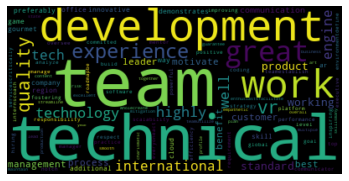


*** Technical Program Manager ***



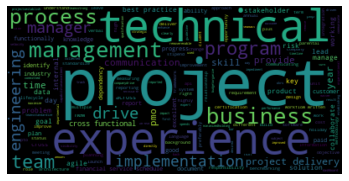


*** Technical Program Manager - Axon ***



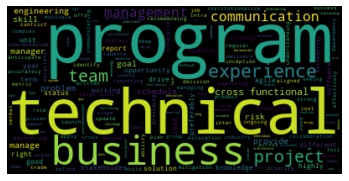


*** Technical Project Manager ***



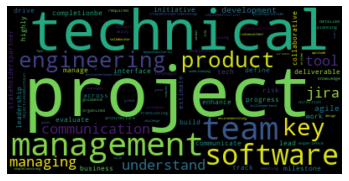


*** Technical Recruiter ***



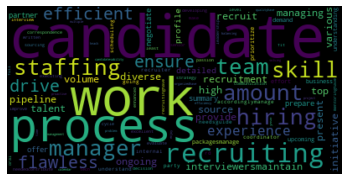


*** Technical Recruiter - Hire Engineers, Product Managers, and Designers - Fully Remote ***



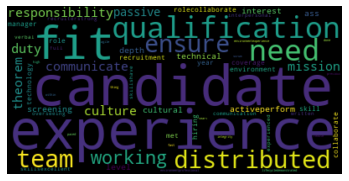


*** Technical Screener ***



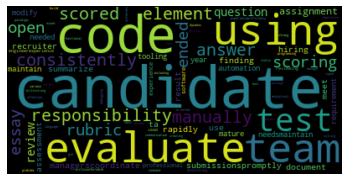


*** Technical Support Engineer ***



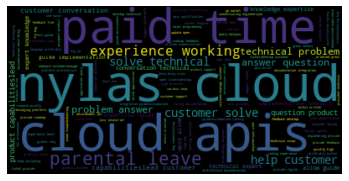


*** Trainer - Customer Operations ***



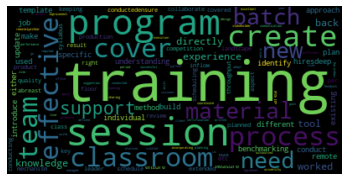


*** Transaction Coordinator ***



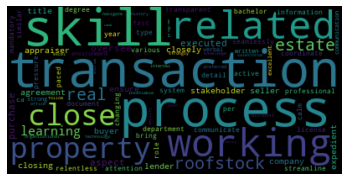


*** Transaction Coordinator - Real Estate ***



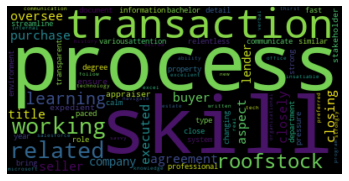


*** Transaction Coordinator - Real Estate  ***



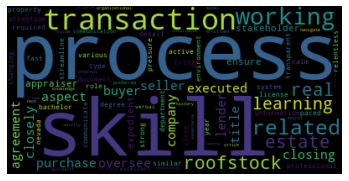


*** UX Design Lead ***



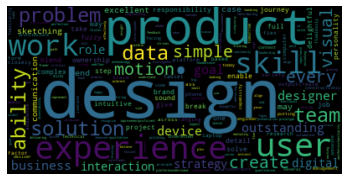


*** UX Design Manager ***



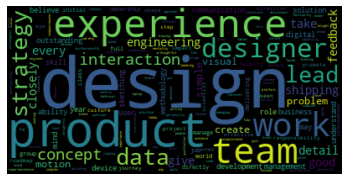


*** UX Designer  ***



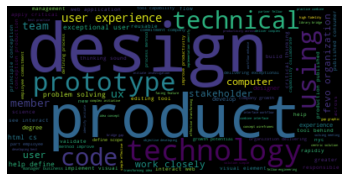


*** UX Writer ***



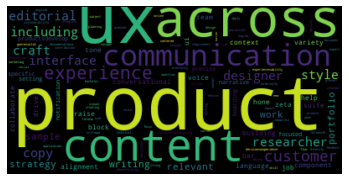


*** Unreal Engine Developer - Blueprints  ***



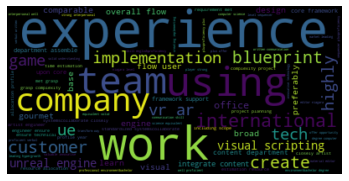


*** Unreal Engineer  ***



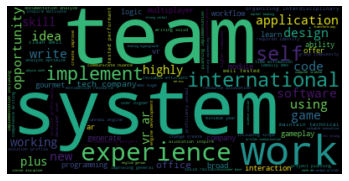


*** User Experience Researcher ***



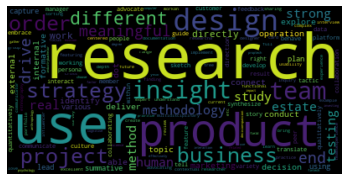


*** User Researcher ***



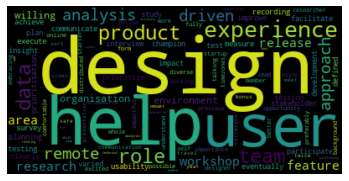


*** VR Background Actor  ***



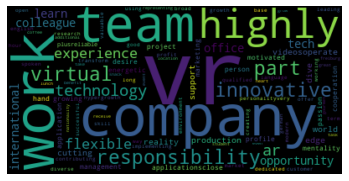


*** Virtual & Augmented Reality Testing - Working Student  ***



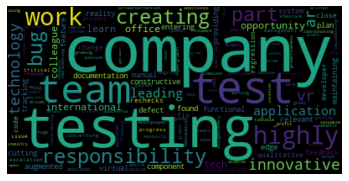


*** Web Developer ***



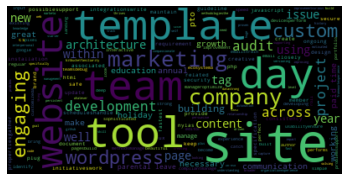

In [27]:
jobs_list = jda.position.unique().tolist()
for job in jobs_list:

    # Start with one review:
    text = jda[jda.position == job].iloc[0].jobDescription
    # Create and generate a word cloud image:
    wordcloud = WordCloud().generate(text)
    print("\n***",job,"***\n")
    # Display the generated image:
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [29]:
## Delete more stop words
other_stop_words = ['junior', 'senior','experience','etc','job','work','company','technique',
                    'candidate','skill','skills','language','menu','inc','new','plus','years',
                   'technology','organization','ceo','cto','account','manager','data','scientist','mobile',
                    'developer','product','revenue','strong', 'vr', 'team', 'higly', 'technical', 'project', 'software', 'business', 'management', 'account']

clean_raw['jobDescription'] = clean_raw['jobDescription'].apply(lambda x: " ".join(x for x in x.split() if x not in other_stop_words))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


# Model Building and Evaluation

In [30]:
# Converting text to features 
vectorizer = TfidfVectorizer()
#Tokenize and build vocabulary
X = vectorizer.fit_transform(clean_raw.jobDescription)
y = clean_raw.position

# split data into 80% training and 20% test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=109) 
print("train data shape: ",X_train.shape)
print("test data shape: ",X_test.shape)

# Fit model
clf = MultinomialNB()
clf.fit(X_train, y_train)
## Predict
y_predicted = clf.predict(X_test)

train data shape:  (403, 6116)
test data shape:  (101, 6116)


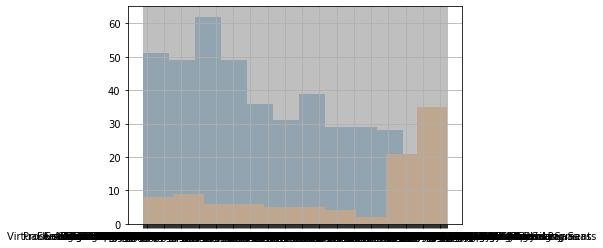

In [31]:
y_train.hist()
y_test.hist()

In [32]:
print("Accuracy score is: ",accuracy_score(y_test, y_predicted))
print("Classes: (to help read Confusion Matrix)\n", clf.classes_)
print("Confusion Matrix: ")

print(confusion_matrix(y_test, y_predicted))
print("Classification Report: ")
print(classification_report(y_test, y_predicted))

Accuracy score is:  0.13861386138613863
Classes: (to help read Confusion Matrix)
 [' Backend Engineer  - C# / .NET Core ' ' Backend Engineer - Java '
 ' Backend Engineer - Node.js  ' ' Backend Engineer - Python'
 ' Backend Engineer - Ruby ' ' Frontend Engineer - React '
 ' Quality Assurance Engineer' 'Account Executive '
 'Account Manager  - Indiana Real Estate License Required'
 'Accounting Manager' 'Accounts Executive' 'Art Manager '
 'Asset Management Analyst' 'Asset Management Associate'
 'Associate - System Support and Process Design'
 'Associate Business Development Manager - UK based '
 'Associate Designer - AR/VR ' 'Associate Director, Product Management'
 'Associate Product Manager ' 'BE Developer '
 'Backend Engineer - Connectivity' 'Banking Operations Associate'
 'Business Analyst ' 'Business Development Associate '
 'Business Development Manager - Americas Focused '
 'Business Development Representative'
 'Cloud Infrastructure Engineering Manager' 'Commercial Account Execut

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Feature Extraction

In [33]:
print(clf.coef_)
print(clf.coef_.shape)

[[-8.72054843 -8.72054843 -8.72054843 ... -8.72054843 -8.65223409
  -8.72054843]
 [-8.72021425 -8.72021425 -8.72021425 ... -8.72021425 -8.72021425
  -8.72021425]
 [-8.72054382 -8.72054382 -8.72054382 ... -8.72054382 -8.72054382
  -8.72054382]
 ...
 [-8.72008796 -8.72008796 -8.72008796 ... -8.72008796 -8.72008796
  -8.72008796]
 [-8.7203695  -8.7203695  -8.7203695  ... -8.7203695  -8.7203695
  -8.7203695 ]
 [-8.72272733 -8.72272733 -8.72272733 ... -8.72272733 -8.72272733
  -8.72272733]]
(276, 6116)


In [38]:
from textblob import TextBlob
technical_skills = ['python', 'c','r', 'c++','java','hadoop','scala','flask','pandas','spark','scikit-learn',
                    'numpy','php','sql','mysql','css','mongdb','nltk','fastai' , 'keras', 'pytorch','tensorflow',
                   'linux','Ruby','JavaScript','django','react','reactjs','ai','ui','tableau']
feature_array = vectorizer.get_feature_names()
# number of overall model features
features_numbers = len(feature_array)
## max sorted features number
n_max = int(features_numbers * 0.1)

##initialize output dataframe
output = pd.DataFrame()
for i in range(0,len(clf.classes_)):
    print("\n****" ,clf.classes_[i],"****\n")
    class_prob_indices_sorted = clf.feature_log_prob_[i, :].argsort()[::-1]
    raw_skills = np.take(feature_array, class_prob_indices_sorted[:n_max])
    print("list of unprocessed skills :")
    print(raw_skills)
    
    ## Extract technical skills
    top_technical_skills= list(set(technical_skills).intersection(raw_skills))[:6]
    #print("Top technical skills",top_technical_skills)
    
    ## Extract adjectives
    
    # Delete technical skills from raw skills list
    ## At this steps, raw skills list doesnt contain the technical skills
    #raw_skills = [x for x in raw_skills if x not in top_technical_skills]
    #raw_skills = list(set(raw_skills) - set(top_technical_skills))

    # transform list to string
    txt = " ".join(raw_skills)
    blob = TextBlob(txt)
    #top 6 adjective
    top_adjectives = [w for (w, pos) in TextBlob(txt).pos_tags if pos.startswith("JJ")][:6]
    #print("Top 6 adjectives: ",top_adjectives)
    
    output = output.append({'job_title':clf.classes_[i],
                        'technical_skills':top_technical_skills,
                        'soft_skills':top_adjectives },
                       ignore_index=True)

Streaming output truncated to the last 5000 lines.
 'finite' 'flight' 'floor' 'florida' 'forest' 'force' 'forecast'
 'forecasting' 'forecastingable' 'forecastswork' 'forefront' 'foreign'
 'forensic' 'form' 'foot' 'formal' 'formalized' 'formally' 'format'
 'formative' 'formatting' 'former' 'formula' 'footprint' 'font' 'flowbank'
 'fluid' 'flowdesigning' 'flowexperience' 'flowscollaborate' 'flowwrite'
 'flowyou' 'fluency' 'fluent' 'fluently' 'flutter' 'follows' 'flywheel'
 'focus' 'focused' 'focusing' 'focusresponsible' 'follow' 'followed'
 'following' 'figure' 'fieldsupport' 'exploring' 'fieldstrong' 'faced'
 'faceted' 'facilitate' 'facilitating' 'facilitation' 'facilitator'
 'facility' 'facing' 'factor' 'factoring' 'failing' 'failure' 'fair'
 'familiar' 'familiarity' 'fanatical' 'faq' 'farmer' 'fashion' 'facebook'
 'face' 'eye' 'extensively' 'exposure' 'extend' 'extended' 'extending'
 'extends' 'extensibility' 'extension' 'extensive' 'extent' 'exude'
 'external' 'externally' 'externall

In [45]:
print(output)

                                             job_title  ...                      technical_skills
0                  Backend Engineer  - C# / .NET Core   ...                       [flask, django]
1                             Backend Engineer - Java   ...  [scala, flask, django, java, python]
2                         Backend Engineer - Node.js    ...                       [flask, python]
3                            Backend Engineer - Python  ...                       [flask, django]
4                             Backend Engineer - Ruby   ...                       [flask, python]
..                                                 ...  ...                                   ...
271                         User Experience Researcher  ...                       [flask, django]
272                                    User Researcher  ...                       [flask, django]
273                               VR Background Actor   ...                       [flask, django]
274  Virtual & Augme

In [46]:
import csv 

with open('jobrec.csv', 'w') as file:
  writer = csv.writer(file)
  writer.writerows(output)